## Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
import pandas as pd
import pickle as pkl
from datetime import datetime
from dateutil import parser
from datetime import datetime
from sys import getsizeof
import re

import operator
from scipy import stats

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
plt.rcParams['figure.figsize'] = (12.0, 8.0)
plt.rcParams['axes.axisbelow'] = True

from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.express as px
init_notebook_mode(True)

import seaborn as sns

from hallprobecalib import hpc_ext_path
from hallprobecalib.hpcplots import scatter2d,scatter3d,histo,py_profile

In [4]:
plotdir = hpc_ext_path+'plots/hall_probe_stability/2019-08-30/'

In [5]:
pkl_dir = hpc_ext_path+"datafiles/hall_probe_stability/"
pkl_file_slow = "hall_stability.run03.raw.slow.pkl"
pkl_file_fast = "hall_stability.run03.raw.fast.pkl"
pkl_file_fast_sparse = "hall_stability.run03.sparse.fast.pkl"

In [26]:
df_slow = pd.read_pickle(pkl_dir+pkl_file_slow)

In [27]:
df_fast = pd.read_pickle(pkl_dir+pkl_file_fast)
#df_fast_sparse = pd.read_pickle(pkl_dir+pkl_file_fast_sparse)

## Cleaning

In [ ]:
directory = "/home/ckampa/Dropbox/LogFiles/"#hpc_ext_path+'datafiles/magnet_stability/nmr/'
filename_slow = '2019-08-30 123158slow.txt' #'2019-08-23 162051slow.txt' # first file stopped Hall probe readings again
filename_fast = '2019-08-30 123800.txt'

In [ ]:
fast_cols_init = ["Date", "Time", 
                  "1", "1_Bx", "1_By", "1_Bz", "1_T",
                  "2", "2_Bx", "2_By", "2_Bz", "2_T",
                  "3", "3_Bx", "3_By", "3_Bz", "3_T",
                  "4", "4_Bx", "4_By", "4_Bz", "4_T",
                  "5", "5_Bx", "5_By", "5_Bz", "5_T",
                  "6", "6_Bx", "6_By", "6_Bz", "6_T",]

In [ ]:
df_slow = pd.read_csv(directory+filename_slow)

In [ ]:
df_slow

In [ ]:
#df_fast = pd.read_csv(directory+filename_fast, skiprows=7, delim_whitespace=True)#, names=fast_cols_init)

In [ ]:
#len(df_fast.columns)

In [ ]:
# skipping many lines from first attempt which failed
df_fast = pd.read_csv(directory+filename_fast, skiprows=32, delim_whitespace=True, names=fast_cols_init)

In [ ]:
df_fast

In [ ]:
for col in df_fast.columns:
    #print(df_fast[col].dtype)
    if type(df_fast[col].iloc[0]) is np.float64:
        print(f"{col}: mean: {df_fast[col].mean()}")

### Cleaning Fast Data Set

In [ ]:
df_fast.head(1)

In [ ]:
df_fast.tail(1)

In [ ]:
df_slow.head(1)

In [ ]:
#df_fast

In [ ]:
'''fast_cols_init = ["Date", "Time", 
                  "1", "1_Bx", "1_By", "1_Bz", "1_T",
                  "2", "2_Bx", "2_By", "2_Bz", "2_T",
                  "3", "3_Bx", "3_By", "3_Bz", "3_T",
                  "4", "4_Bx", "4_By", "4_Bz", "4_T",
                  "5", "5_Bx", "5_By", "5_Bz", "5_T",]''';

In [ ]:
#len(fast_cols_init)

In [ ]:
#len(df_fast.columns)

In [ ]:
# raw values on every other line....
df_fast_cal = df_fast[::2]
df_fast_raw = df_fast[1::2]

In [ ]:
df_fast_cal.reset_index(drop=True, inplace=True)
df_fast_raw.reset_index(drop=True, inplace=True)

In [ ]:
#df_fast_cal

In [ ]:
#df_fast_raw

In [ ]:
#dates = [parser.parse(row.Date+" "+row.Time[:-4]) for row in df_fast_cal.itertuples()]
dates = [datetime.strptime(row.Date+" "+row.Time, "%Y-%m-%d %H:%M:%S:%f") for row in df_fast_cal.itertuples()]

In [ ]:
df_fast_cal["Datetime"] = pd.to_datetime(dates)
df_fast_cal = df_fast_cal.set_index("Datetime")

In [ ]:
#dates = [parser.parse(row.Date+" "+row.Time[:-4]) for row in df_fast_cal.itertuples()]
dates = [datetime.strptime(row.Date[1:]+" "+row.Time, "%Y-%m-%d %H:%M:%S:%f") for row in df_fast_raw.itertuples()]

In [ ]:
df_fast_raw["Datetime"] = pd.to_datetime(dates)
df_fast_raw = df_fast_raw.set_index("Datetime")

In [ ]:
df_fast_raw.drop(columns=["Date","Time"], inplace=True)

In [ ]:
df_fast_cal.drop(columns=["Date","Time"], inplace=True)

In [ ]:
raw_col_dict = {i: "Raw_"+i for i in df_fast_raw.columns}
cal_col_dict = {i: "Cal_"+i for i in df_fast_cal.columns}

In [ ]:
df_fast_cal.rename(columns=cal_col_dict, inplace=True)
df_fast_raw.rename(columns=raw_col_dict, inplace=True)

In [ ]:
df_fast = pd.concat([df_fast_cal, df_fast_raw], axis=1)

### Slow Control Data Cleaning

In [ ]:
dates = [parser.parse(row.Time) for row in df_slow.itertuples()]# if isdatetime(row.Time.values[0])]

In [ ]:
df_slow["Datetime"] = pd.to_datetime(dates)#.astype("str")
df_slow = df_slow.set_index("Datetime")

There is no Hall probe data.

In [ ]:
df_fast = df_fast.loc[:df_slow.index[-1]]

In [ ]:
df_fast.loc[:,"NMR"] = [df_slow.iloc[df_slow.index.get_loc(row, method='nearest')][" NMR [T]"] for row in df_fast.index]

In [ ]:
for i in range(1,6):
    df_fast.eval(f"Cal_{i}_Bmag = (Cal_{i}_Bx**2+Cal_{i}_By**2+Cal_{i}_Bz**2)**(1/2)", inplace=True)
    df_fast.eval(f"Cal_{i}_Res = (NMR - Cal_{i}_Bmag)", inplace=True)
    df_fast.eval(f"Cal_{i}_Res_Rel = (NMR - Cal_{i}_Bmag) / NMR", inplace=True)

for i in range(1,6):
    for B in ["Bx","By","Bz"]:
        #df_fast.eval(f"Cal_{i}_Bmag = (Cal_{i}_Bx**2+Cal_{i}_By**2+Cal_{i}_Bz**2)**(1/2)", inplace=True)
        df_fast.eval(f"Cal_{i}_{B}_Res = (NMR - Cal_{i}_{B})", inplace=True)
        df_fast.eval(f"Cal_{i}_{B}_Res_Rel = (NMR - Cal_{i}_{B}) / NMR", inplace=True)


t0 = pd.to_timedelta(df_fast.index.values)[0] / pd.offsets.Second(1)

df_fast["seconds_delta"] = pd.to_timedelta(df_fast.index.values) / pd.offsets.Second(1) - t0#1565697533.416
df_slow["seconds_delta"] = pd.to_timedelta(df_slow.index.values) / pd.offsets.Second(1) - t0#1565697533.416

In [ ]:
for i in range(1,6):
    df_fast[f"Cal_{i}_Transverse"] = (df_fast[f"Cal_{i}_Bx"]**2+df_fast[f"Cal_{i}_By"]**2)**(1/2)
    df_fast[f"Cal_{i}_Theta"] = np.arccos(df_fast[f"Cal_{i}_Bz"]/df_fast[f"Cal_{i}_Bmag"])
    df_fast[f"Cal_{i}_Phi"] = np.arccos(df_fast[f"Cal_{i}_Bx"]/df_fast[f"Cal_{i}_Transverse"])

In [ ]:
df_slow.to_pickle(pkl_dir+pkl_file_slow)

In [ ]:
df_fast.to_pickle(pkl_dir+pkl_file_fast)

In [ ]:
col_drop = [i for i in df_fast.columns if ("1" not in i) and ("NMR" not in i)]

In [ ]:
#col_drop

In [ ]:
df_fast_sparse = df_fast.drop(columns=col_drop)

In [ ]:
df_fast_sparse.to_pickle(pkl_dir+pkl_file_fast_sparse)

In [ ]:
getsizeof(df_slow) / 1000/1000, getsizeof(df_fast) / 1000/1000, getsizeof(df_fast_sparse) / 1000/1000

## Plotting

### First Attempt

In [10]:
len(df_slow)

4231

In [8]:
len(df_fast)

24373

In [9]:
df_fast.columns

Index(['Cal_1', 'Cal_1_Bx', 'Cal_1_By', 'Cal_1_Bz', 'Cal_1_T', 'Cal_2',
       'Cal_2_Bx', 'Cal_2_By', 'Cal_2_Bz', 'Cal_2_T',
       ...
       'Cal_2_Phi', 'Cal_3_Transverse', 'Cal_3_Theta', 'Cal_3_Phi',
       'Cal_4_Transverse', 'Cal_4_Theta', 'Cal_4_Phi', 'Cal_5_Transverse',
       'Cal_5_Theta', 'Cal_5_Phi'],
      dtype='object', length=122)

In [28]:
cols = df_fast.columns

In [29]:
print([c for c in cols if "Cal_1" in c])

['Cal_1', 'Cal_1_Bx', 'Cal_1_By', 'Cal_1_Bz', 'Cal_1_T', 'Cal_1_Bmag', 'Cal_1_Res', 'Cal_1_Res_Rel', 'Cal_1_Bx_Res', 'Cal_1_Bx_Res_Rel', 'Cal_1_By_Res', 'Cal_1_By_Res_Rel', 'Cal_1_Bz_Res', 'Cal_1_Bz_Res_Rel', 'Cal_1_Transverse', 'Cal_1_Theta', 'Cal_1_Phi']


In [30]:
fig = scatter2d(df_slow.index, df_slow[" NMR [T]"])

In [32]:
#for cal in ["1", "2", "3", "4", "5"]:
#    fig = scatter2d(df_fast.index, df_fast[f"Cal_{cal}_Bmag"])

Probe #4 is in the magnet.

In [33]:
P = 4
N = 10#30#10#20#10#30#60
df_fast.loc[:, f"Cal_{P}_Bmag_Avg"] = df_fast[f"Cal_{P}_Bmag"].rolling(window = N, center=True).mean()
df_fast.loc[:, f"Cal_{P}_Bmag_Avg_Res_Rel"] = (df_fast["NMR"] - df_fast[f"Cal_{P}_Bmag_Avg"])/df_fast["NMR"]

In [34]:
df_fast_5 = df_fast[N // 2::N]

In [ ]:
#df_fast_5.loc[:, "Cal_Mag_Avg"] = [df_fast.iloc[i- for i in range(len(df_fast_5))]

In [ ]:
### 60 second

In [35]:
fig = px.scatter_matrix(df_fast, dimensions=["NMR","Cal_1_Bmag","Cal_2_Bmag","Cal_3_Bmag","Cal_4_Bmag","Cal_5_Bmag",])
fig.show()

In [39]:
len(df_fast)

24373

In [43]:
perc = 0.001
bad_map = (df_fast[f"Cal_{P}_Bmag"] < df_fast[f"Cal_{P}_Bmag"].quantile(perc)) | (df_fast[f"Cal_{P}_Bmag"] > df_fast[f"Cal_{P}_Bmag"].quantile(1-perc))

In [44]:
df_fast[bad_map]

,Cal_1,Cal_1_Bx,Cal_1_By,Cal_1_Bz,Cal_1_T,Cal_2,Cal_2_Bx,Cal_2_By,Cal_2_Bz,Cal_2_T,...,Cal_3_Theta,Cal_3_Phi,Cal_4_Transverse,Cal_4_Theta,Cal_4_Phi,Cal_5_Transverse,Cal_5_Theta,Cal_5_Phi,Cal_4_Bmag_Avg,Cal_4_Bmag_Avg_Res_Rel
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-08-30 12:43:52.775,1,0.000035,-0.000011,-0.000229,19.62,2,-0.000069,0.000243,-0.000114,19.37,...,2.477001,1.420425,1.050797,2.142671,1.560412,0.000236,2.716254,0.292268,1.249669,-0.000233
2019-08-30 12:44:41.797,1,0.000032,-0.000042,-0.000249,19.61,2,-0.000051,0.000270,-0.000150,19.36,...,2.381333,1.469875,1.050677,2.142870,1.560514,0.000249,2.670249,0.214744,1.249690,-0.000250
2019-08-30 12:51:23.961,1,-0.000017,-0.000009,-0.000212,19.46,2,-0.000033,0.000255,-0.000157,19.25,...,2.612614,1.323906,1.048751,2.145694,1.557439,0.000244,2.707932,0.110657,1.249701,-0.000260
2019-08-30 12:51:35.967,1,0.000003,-0.000032,-0.000217,19.46,2,-0.000084,0.000269,-0.000139,19.25,...,2.657887,1.405648,1.048685,2.145799,1.557433,0.000248,2.685968,0.269436,1.249682,-0.000245
2019-08-30 12:53:27.013,1,0.000002,0.000011,-0.000223,19.42,2,-0.000061,0.000257,-0.000144,19.21,...,2.564482,1.305120,1.048120,2.146636,1.556922,0.000265,2.657758,0.399438,1.249683,-0.000247
2019-08-30 12:54:02.025,1,-0.000005,-0.000003,-0.000211,19.41,2,-0.000039,0.000248,-0.000115,19.21,...,2.470931,1.538960,1.047921,2.146917,1.556682,0.000248,2.704279,0.315381,1.249675,-0.000241
2019-08-30 12:55:35.065,1,0.000026,0.000027,-0.000217,19.39,2,-0.000083,0.000256,-0.000124,19.19,...,2.601873,1.522888,1.047573,2.147439,1.556150,0.000236,2.707709,0.296321,1.249678,-0.000243
2019-08-30 12:59:42.167,1,0.000020,-0.000017,-0.000250,19.33,2,-0.000038,0.000275,-0.000122,19.14,...,2.318198,1.204108,1.047108,2.148120,1.556063,0.000266,2.693721,0.401438,1.249681,-0.000246
2019-08-30 12:59:45.169,1,0.000021,0.000031,-0.000202,19.33,2,-0.000041,0.000258,-0.000175,19.14,...,2.517937,1.603897,1.047116,2.148109,1.556043,0.000258,2.673145,0.287366,1.249682,-0.000247


In [46]:
df_fast2 = df_fast[~bad_map]

In [72]:
df_fast2.loc[:, f"Cal_{P}_Bmag_Avg"] = df_fast2[f"Cal_{P}_Bmag"].rolling(window = N, center=True).mean()
df_fast2.loc[:, f"Cal_{P}_Bmag_Avg_Res_Rel"] = (df_fast2["NMR"] - df_fast2[f"Cal_{P}_Bmag_Avg"])/df_fast2["NMR"]

In [74]:
df_fast2_5 = df_fast2[N // 2::N]

In [71]:
#fig = px.scatter_matrix(df_fast2, dimensions=["NMR","Cal_1_Bmag","Cal_2_Bmag","Cal_3_Bmag","Cal_4_Bmag","Cal_5_Bmag",])
#fig.show()

In [70]:
#plot(fig)

In [69]:
#fig = scatter2d(df_fast2.NMR, df_fast2[f"Cal_{P}_Bmag"], lines=False, markers=True)

In [50]:
from scipy import stats

In [66]:
primary_corr = dict()
for col in df_slow.columns:
    if (df_slow[col].dtype == np.float64):
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df_slow[col], df_slow[" NMR [T]"])
        #print(col,r_value_v,p_value_v,std_err_v)
        primary_corr[col] = r_value_v

sorted_primary_corr = sorted(primary_corr.items(), key=operator.itemgetter(1))

sorted_primary_corr

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:107: RuntimeWarning:

invalid value encountered in double_scalars

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:119: RuntimeWarning:

divide by zero encountered in double_scalars



[(' Yoke', -0.9966540466279962),
 ('Yoke (center magnet)', -0.9915358565559163),
 (' Floor', -0.9422776659142951),
 (' Chamber Wall CH14', -0.896132477714903),
 (' Hall Element', -0.8954839645701962),
 (' Chamber Wall CH15', -0.8929324621433391),
 (' Chamber Wall CH13', -0.8820263262850101),
 (' LCW in Coil 2', -0.8801073631580498),
 (' Chamber Wall CH17', -0.8791710410321052),
 (' Chamber Wall CH18', -0.8776489572790537),
 (' Chamber Wall CH19', -0.8748798834960279),
 (' Chamber Wall CH20', -0.8724384836839479),
 (' Roof', -0.8723046705662006),
 (' Chamber Wall CH16', -0.8712882087946431),
 (' Coil 2 (old)', -0.8700212864717232),
 (' LCW to barrel', -0.8688656963311785),
 ('LCW to PS', -0.8673411893611932),
 (' LCW in barrel', -0.858333610472203),
 ('Coil 1 (new)', -0.8573577583586438),
 (' Magnet Voltage [V]', -0.8441388436049583),
 (' LCW out Coil 2', -0.84396277866008),
 (' LCW out Coil 1', -0.8398877414121758),
 (' ICW HE1 out', -0.8380416697444558),
 (' LCW in Coil1', -0.83716110

In [62]:
primary_corr = dict()
for col in df_fast2.columns:
    if (df_fast2[col].dtype == np.float64) & ("T" not in col) & ("Cal_4" in col):
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df_fast2[col], df_fast2["NMR"])
        #print(col,r_value_v,p_value_v,std_err_v)
        primary_corr[col] = r_value_v

sorted_primary_corr = sorted(primary_corr.items(), key=operator.itemgetter(1))

sorted_primary_corr

[('Cal_4_Bz', -0.2490607084635465),
 ('Cal_4_By_Res_Rel', -0.23530832599410992),
 ('Cal_4_By_Res', -0.19001423542200493),
 ('Cal_4_Res', -0.1273372247576881),
 ('Cal_4_Res_Rel', -0.12718305007869296),
 ('Cal_4_Phi', -0.0952639062909486),
 ('Cal_4_Bx_Res_Rel', -0.09327442909939374),
 ('Cal_4_Bx_Res', -0.06833666454043992),
 ('Cal_4_Bx', 0.09358849207342033),
 ('Cal_4_By', 0.21483437084559068),
 ('Cal_4_Bz_Res_Rel', 0.24049763762918858),
 ('Cal_4_Bz_Res', 0.26457075540658953),
 ('Cal_4_Bmag', 0.5747200915044767),
 ('Cal_4_Bmag_Avg', nan),
 ('Cal_4_Bmag_Avg_Res_Rel', nan)]

In [55]:
df_fast2["Cal_4_Bmag_Avg_Res_Rel"].describe()

count    24317.000000
mean        -0.000392
std          0.004315
min         -0.100458
25%         -0.000289
50%         -0.000282
75%         -0.000271
max          0.299826
Name: Cal_4_Bmag_Avg_Res_Rel, dtype: float64

In [57]:
df_fast2["NMR"].describe()

count    24323.000000
mean         1.249389
std          0.000014
min          1.249371
25%          1.249375
50%          1.249388
75%          1.249402
max          1.249415
Name: NMR, dtype: float64

In [60]:
len(df_fast2)

24323

In [65]:
fig = histo(df_fast2[f"Cal_{P}_Res_Rel"], bins=50)

In [17]:
fig = scatter2d([df_fast.index,df_fast.index,df_fast_5.index], [df_fast.Cal_1_Bmag,df_fast.Cal_1_Bmag_Avg,df_fast_5.Cal_1_Bmag_Avg], inline=True)

In [75]:
fig = histo(df_fast2[f'Cal_{P}_Bmag'], bins=50, inline=True)
fig = histo(df_fast2[f'Cal_{P}_Bmag_Avg'], bins=50, inline=True)
fig = histo(df_fast2_5[f'Cal_{P}_Bmag_Avg'], bins=50, inline=True)

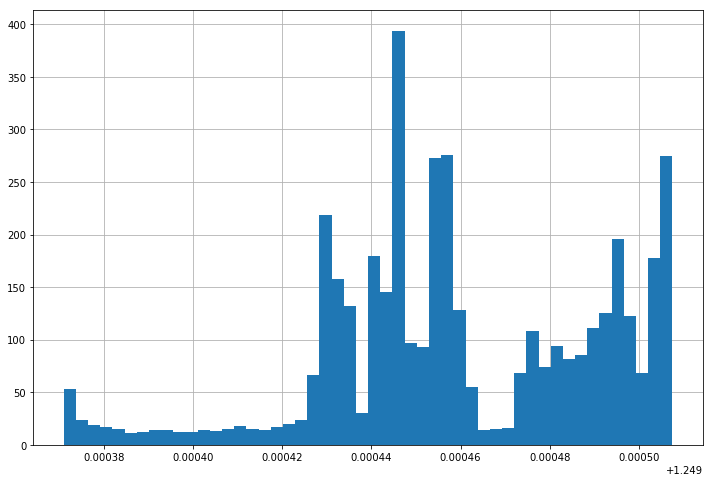

In [76]:
df_slow[" NMR [T]"].hist(bins=50)

In [20]:
df_fast.eval("Cal_Res = (NMR - Cal_1_Bmag)", inplace=True)
df_fast.eval("Cal_Res_Rel = (NMR - Cal_1_Bmag) / NMR", inplace=True)

In [77]:
fig = histo(df_fast2.Cal_4_Res_Rel, bins=50, inline=True)
fig = histo(df_fast2.Cal_4_Bmag_Avg_Res_Rel, bins=50, inline=True)
fig = histo(df_fast2_5.Cal_4_Bmag_Avg_Res_Rel, bins=50, inline=True)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)

In [78]:
fig = histo(df_slow[" NMR [T]"], bins=10, inline=True)

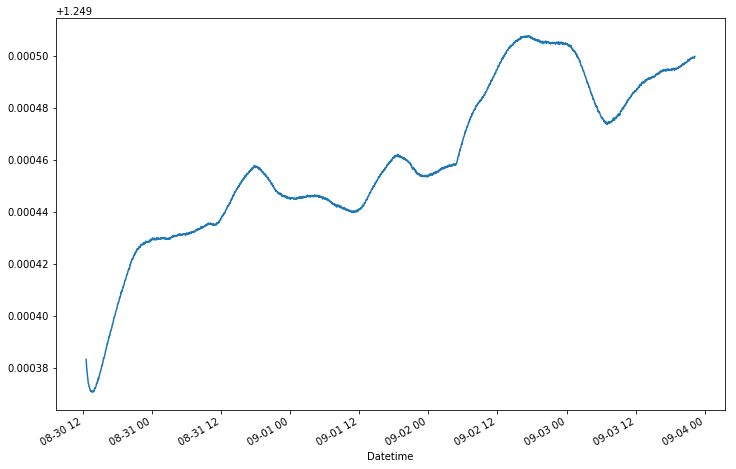

In [79]:
df_slow[" NMR [T]"].plot()

In [80]:
fig = scatter2d(df_slow.index, df_slow[" NMR [T]"], inline=True)

In [88]:
fig = scatter2d(df_fast2.index, df_fast2[f"Cal_{P}_Bmag"], inline=True)

In [81]:
import copy

In [85]:
# Seeing effect of number of points in average
#N = 10#30#10#20#10#30#60
P = 4
Ns = [1,5,10,30,60, 120,]# 240, 480, 960, 1930,1930*2, 1930*4, 1930*8]#[5, 10, 30, 60]

df_fast_N = []

for N in Ns:
    df_fast2.loc[:, f"Cal_{P}_Bmag_Avg"] = df_fast2[f"Cal_{P}_Bmag"].rolling(window = N, center=True).mean()
    df_fast2.loc[:, f"Cal_{P}_Bmag_Avg_Res_Rel"] = (df_fast2["NMR"] - df_fast2[f"Cal_{P}_Bmag_Avg"])/df_fast2["NMR"]
    df_fast_N.append(copy.copy(df_fast2[N // 2::N]))
    #print(df_fast_N[-1]["Cal_1_Bmag_Avg_Res_Rel"].describe())

#df_fast_5 = df_fast[N // 2::N]
#print([df[f"Cal_{P}_Bmag_Avg_Res_Rel"].describe() for df in df_fast_N])
[df[f"Cal_{P}_Bmag_Avg_Res_Rel"].describe() for df in df_fast_N]

[count    24323.000000
 mean        -0.000279
 std          0.000020
 min         -0.000344
 25%         -0.000293
 50%         -0.000280
 75%         -0.000266
 max         -0.000191
 Name: Cal_4_Bmag_Avg_Res_Rel, dtype: float64, count    4864.000000
 mean       -0.000279
 std         0.000015
 min        -0.000318
 25%        -0.000290
 50%        -0.000281
 75%        -0.000270
 max        -0.000223
 Name: Cal_4_Bmag_Avg_Res_Rel, dtype: float64, count    2432.000000
 mean       -0.000279
 std         0.000013
 min        -0.000310
 25%        -0.000289
 50%        -0.000282
 75%        -0.000271
 max        -0.000229
 Name: Cal_4_Bmag_Avg_Res_Rel, dtype: float64, count    810.000000
 mean      -0.000279
 std        0.000012
 min       -0.000300
 25%       -0.000288
 50%       -0.000283
 75%       -0.000271
 max       -0.000235
 Name: Cal_4_Bmag_Avg_Res_Rel, dtype: float64, count    405.000000
 mean      -0.000279
 std        0.000012
 min       -0.000296
 25%       -0.000288
 50%   

In [89]:
df_fast_N[0][f"Cal_{P}_Bmag_Avg_Res_Rel"].describe()

count    24323.000000
mean        -0.000279
std          0.000020
min         -0.000344
25%         -0.000293
50%         -0.000280
75%         -0.000266
max         -0.000191
Name: Cal_4_Bmag_Avg_Res_Rel, dtype: float64

In [91]:
fig = scatter2d([df_fast2.index, df_fast_N[-2].index, df_slow.index], [df_fast2.Cal_4_Bmag,df_fast_N[-2].Cal_4_Bmag_Avg, df_slow[" NMR [T]"]], inline=True)

In [ ]:
fig = histo([df_fast.Cal_Res_Rel]+[df.Cal_1_Bmag_Avg_Res_Rel for df in df_fast_N], bins=50,same_bins=True, show_plot=False, opacity=0.5, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)

In [ ]:
fig = histo([df_fast.Cal_Res_Rel]+[df.Cal_1_Bmag_Avg_Res_Rel for df in [df_fast_N[0]]], bins=50,same_bins=False, show_plot=False, opacity=0.5, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)

In [ ]:
fig = histo([df.Cal_1_Bmag_Avg_Res_Rel for df in [df_fast_N[0]]], bins=50,same_bins=False, show_plot=True, opacity=0.5, inline=True)

In [ ]:
df_fast_N[0]["Cal_1_Bmag_Avg_Res_Rel"].describe()

In [ ]:
getsizeof(df_fast_N[0]) / 1000 / 1000

### Noise on all Hall probes

In [ ]:
#df_fast.columns

In [ ]:
'''for i in range(1,6):
    df_fast.eval(f"Cal_{i}_Bmag = (Cal_{i}_Bx**2+Cal_{i}_By**2+Cal_{i}_Bz**2)**(1/2)", inplace=True)
    df_fast.eval(f"Cal_{i}_Res = (NMR - Cal_{i}_Bmag)", inplace=True)
    df_fast.eval(f"Cal_{i}_Res_Rel = (NMR - Cal_{i}_Bmag) / NMR", inplace=True)

for i in range(1,6):
    for B in ["Bx","By","Bz"]:
        #df_fast.eval(f"Cal_{i}_Bmag = (Cal_{i}_Bx**2+Cal_{i}_By**2+Cal_{i}_Bz**2)**(1/2)", inplace=True)
        df_fast.eval(f"Cal_{i}_{B}_Res = (NMR - Cal_{i}_{B})", inplace=True)
        df_fast.eval(f"Cal_{i}_{B}_Res_Rel = (NMR - Cal_{i}_{B}) / NMR", inplace=True)

df_fast["seconds_delta"] = pd.to_timedelta(df_fast.index.values) / pd.offsets.Second(1) - 1565697533.416

df_slow["seconds_delta"] = pd.to_timedelta(df_slow.index.values) / pd.offsets.Second(1) - 1565697533.416''';

In [ ]:
#pd.to_timedelta(df_slow.index.values) / pd.offsets.Second(1)

In [ ]:
getsizeof(df_fast) / 1000 / 1000

In [ ]:
# relative residual

In [ ]:
for i in range(1,6):
    for B in ["Bx", "By", "Bz"]:
        fig = histo(df_fast[f"Cal_{i}_{B}_Res_Rel"], bins=50, show_plot=False, inline=True)
        filename = f"histo_Cal_{i}_{B}_Res_Rel"
        pio.write_image(fig, plotdir+f"relative_residuals/components/{filename}.pdf")
        pio.write_image(fig, plotdir+f"relative_residuals/components/{filename}.png")

In [ ]:
for i in range(1,6):
    fig = histo(df_fast[f"Cal_{i}_Res_Rel"], bins=50, show_plot=False, inline=True)
    filename = f"histo_Cal_{i}_Res_Rel"
    pio.write_image(fig, plotdir+f"relative_residuals/magnitude/{filename}.pdf")
    pio.write_image(fig, plotdir+f"relative_residuals/magnitude/{filename}.png")

In [ ]:
# residual

In [ ]:
for i in range(1,6):
    for B in ["Bx", "By", "Bz"]:
        fig = histo(df_fast[f"Cal_{i}_{B}_Res"], bins=50, show_plot=False, inline=True)
        filename = f"histo_Cal_{i}_{B}_Res"
        pio.write_image(fig, plotdir+f"residuals/components/{filename}.pdf")
        pio.write_image(fig, plotdir+f"residuals/components/{filename}.png")

In [ ]:
for i in range(1,6):
    fig = histo(df_fast[f"Cal_{i}_Res"], bins=50, show_plot=False, inline=True)
    filename = f"histo_Cal_{i}_Res"
    pio.write_image(fig, plotdir+f"residuals/magnitude/{filename}.pdf")
    pio.write_image(fig, plotdir+f"residuals/magnitude/{filename}.png")

In [ ]:
Ns = [5,10,30,60, 120, 240, 480, 960, 1930,1930*2, 1930*4, 1930*8]#[5, 10, 30, 60]

df_fast_N = []

for N in Ns:
    df_fast.loc[:, "Cal_1_Bmag_Avg"] = df_fast["Cal_1_Bmag"].rolling(window = N, center=True).mean()
    df_fast.loc[:, "Cal_1_Bmag_Avg_Res_Rel"] = (df_fast["NMR"] - df_fast["Cal_1_Bmag_Avg"])/df_fast["NMR"]
    df_fast_N.append(copy.copy(df_fast[N // 2::N]))


### Check Field Angle and Average
- Leaving for historical purposes, but column names have changed

In [ ]:
'''df_fast["Cal_1_Transverse"] = (df_fast["Cal_1_Bx"]**2+df_fast["Cal_1_By"]**2)**(1/2)
df_fast["theta"] = np.arccos(df_fast["Cal_1_Bz"]/df_fast["Cal_1_Bmag"])
df_fast["phi"] = np.arccos(df_fast["Cal_1_Bx"]/df_fast["Cal_1_Transverse"])''';

In [ ]:
fig = histo(df_fast.theta*180/np.pi, bins=50, inline=True)
fig = histo(df_fast.phi*180/np.pi, bins=50, inline=True)

In [ ]:
# Seeing effect of number of points in average
#N = 10#30#10#20#10#30#60
Ns = [5,10,30,60, 120, 240, ]#480, 960, 1930,1930*2, 1930*4, 1930*8]#[5, 10, 30, 60]

df_fast_N = []

for N in Ns:
    df_fast.loc[:, "theta_Avg"] = df_fast["theta"].rolling(window = N, center=True).mean()
    df_fast.loc[:, "phi_Avg"] = df_fast["phi"].rolling(window = N, center=True).mean()
    df_fast_N.append(copy.copy(df_fast[N // 2::N]))
    #print(df_fast_N[-1]["Cal_1_Bmag_Avg_Res_Rel"].describe())

#df_fast_5 = df_fast[N // 2::N]
#print([df["Cal_1_Bmag_Avg_Res_Rel"].describe() for df in df_fast_N])

In [ ]:
fig = histo([df_fast.theta]+[df.theta_Avg for df in df_fast_N], bins=50,same_bins=True, show_plot=False, opacity=0.5, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)

In [ ]:
fig = scatter2d(df_fast.index, df_fast.theta, inline=True)

In [ ]:
fig = scatter2d(df_fast.index, df_fast.phi, inline=True)

In [ ]:
df_fast_N[0].theta_Avg.plot()

In [ ]:
fig = scatter2d([df_fast.index, df_fast_N[2].index, df_slow.index], [df_fast.Cal_1_Bmag,df_fast_N[2].Cal_1_Bmag_Avg, df_slow[" NMR [T]"]], inline=True)

### Plots for Email

In [ ]:
# get probe name dictionary
directory = "/home/ckampa/Dropbox/LogFiles/"
filename_fast = '2019-08-13 1155830 hallonly.txt'

with open(directory+filename_fast, 'r') as file:
    lines = file.readlines()[1:6]

In [ ]:
lines

In [ ]:
id_reg = re.compile(": (.+?)  Offset")

In [ ]:
hall_ids_list = [id_reg.findall(line)[0] for line in lines]

In [ ]:
hall_ids_list

In [ ]:
hall_ids = {i+1: hall for i,hall in enumerate(hall_ids_list)}

In [ ]:
hall_ids

In [ ]:
fig = scatter2d(df_fast.index, df_fast["Raw_4_Bx"], inline=True)

In [ ]:
fig = scatter2d(df_fast.index, df_fast["Raw_4_Bz"], inline=True)

In [ ]:
fig = scatter2d(df_fast.index, df_fast["Cal_4_Bz"], inline=True)

In [ ]:
fig = scatter2d(5*[df_fast.index], [df_fast[f'Cal_{i}_T'] for i in range(1,6)])

In [ ]:
fig = scatter2d([df_fast.seconds_delta, df_slow.seconds_delta], [df_fast[f'Cal_1_T'], df_slow[" Hall Element"]],show_plot=False)

In [ ]:
figprof = py_profile(df_fast.seconds_delta, df_fast.Cal_1_T, x_bins=50, show_plot=False)

In [ ]:
figprof2 = py_profile(df_slow.seconds_delta, df_slow[" Hall Element"], x_bins=50,xrange=[df_fast.seconds_delta.min(),df_fast.seconds_delta.max()], show_plot=False)

In [ ]:
fig.add_traces([figprof.data[0],figprof2.data[0]])

In [ ]:
df_fast.loc[:,"HallElement"] = [df_slow.iloc[df_slow.index.get_loc(row, method='nearest')][" Hall Element"] for row in df_fast.index]

In [ ]:
#fig = scatter2d(df_fast.HallElement, df_fast.Cal_1_T, markers=True, lines=False)

In [ ]:
fig = py_profile(df_fast.HallElement, df_fast.Cal_1_T, x_bins=12)

In [ ]:
df_fast["Cal_4_Bmag"].describe()

In [ ]:
fig = scatter2d(df_fast.index, df_fast["Cal_1_Bmag"], inline=True)

In [ ]:
fig = scatter2d(df_slow_old.index, df_slow_old[" NMR [T]"], inline=True)

In [ ]:
fig = scatter2d(df_slow.index, df_slow[" NMR [T]"], inline=True)

In [ ]:
start = 0
end = 600
x_bins = 20

In [ ]:
fig = scatter2d(df_fast.seconds_delta[start:end], df_fast.Cal_1_Bmag[start:end],show_plot=False)

In [ ]:
figprof = py_profile(df_fast.seconds_delta[start:end], df_fast.Cal_1_Bmag[start:end], x_bins = x_bins, show_plot=False)

In [ ]:
fig.add_trace(figprof.data[0])

In [ ]:
#fig.update_traces(visible=False)

In [ ]:
pio.write_image(fig, plotdir+"scatter_plus_profile_test.pdf")

In [ ]:
start = 1000
end = 1600
x_bins = 20

comp_old = "Mag"
comp_new = "Bmag"

In [ ]:
# old data
fig = scatter2d(df_slow_old.seconds_delta[start:end], df_slow_old[f"Cal_{comp_old}"][start:end],show_plot=False)
figprof = py_profile(df_slow_old.seconds_delta[start:end], df_slow_old[f"Cal_{comp_old}"][start:end], x_bins = x_bins, show_plot=False)
fig.add_trace(figprof.data[0])

In [ ]:
for i in range(1,6):
    fig = scatter2d(df_fast.seconds_delta[start:end], df_fast[f'Cal_{i}_{comp_new}'][start:end],show_plot=False)
    figprof = py_profile(df_fast.seconds_delta[start:end], df_fast[f'Cal_{i}_{comp_new}'][start:end], x_bins = x_bins, show_plot=False)
    fig.add_trace(figprof.data[0])
    iplot(fig)

In [ ]:
start = 1000
end = 1120
x_bins = 6

In [ ]:
# old data
fig = scatter2d(df_slow_old.seconds_delta[start:end], df_slow_old[f"Cal_{comp_old}"][start:end],show_plot=False)
figprof = py_profile(df_slow_old.seconds_delta[start:end], df_slow_old[f"Cal_{comp_old}"][start:end], x_bins = x_bins, show_plot=False)
fig.add_trace(figprof.data[0])

In [ ]:
for i in range(1,6):
    fig = scatter2d(df_fast.seconds_delta[start:end], df_fast[f'Cal_{i}_{comp_new}'][start:end],show_plot=False)
    figprof = py_profile(df_fast.seconds_delta[start:end], df_fast[f'Cal_{i}_{comp_new}'][start:end], x_bins = x_bins, show_plot=False)
    fig.add_trace(figprof.data[0])
    iplot(fig)

In [ ]:
fig = histo(df_fast.Cal_1_Res_Rel, bins=50, show_plot=False)
fig.layout.xaxis.title = ("(NMR - |B_hall|) / NMR")
iplot(fig)

In [ ]:
df_slow_old["Cal_Res_Rel"] = (df_slow_old[" NMR [T]"] - df_slow_old["Cal"]) / df_slow_old[" NMR [T]"]

In [ ]:
df_slow_old = df_slow_old.loc["2019-08-10 12:30:00":]

In [ ]:
fig = histo(df_slow_old.Cal_Mag_Res_Rel, bins=50, show_plot=False)
fig.layout.xaxis.title = ("(NMR - |B_hall|) / NMR")
iplot(fig)

In [ ]:
df_slow_old.columns

In [ ]:
## AVERAGING

In [ ]:
import copy

In [ ]:
# Seeing effect of number of points in average
#N = 10#30#10#20#10#30#60
Ns = [10,60]#[5, 10, 30, 60]

df_fast_N = []

for N in Ns:
    df_fast.loc[:, "Cal_1_Bmag_Avg"] = df_fast["Cal_1_Bmag"].rolling(window = N, center=True).mean()
    df_fast.loc[:, "Cal_1_Bmag_Avg_Res_Rel"] = (df_fast["NMR"] - df_fast["Cal_1_Bmag_Avg"])/df_fast["NMR"]
    df_fast_N.append(copy.copy(df_fast[N // 2::N]))
    #print(df_fast_N[-1]["Cal_1_Bmag_Avg_Res_Rel"].describe())

#df_fast_5 = df_fast[N // 2::N]
#print([df["Cal_1_Bmag_Avg_Res_Rel"].describe() for df in df_fast_N])

In [ ]:
fig = histo([df_fast.Cal_1_Res_Rel]+[df.Cal_1_Bmag_Avg_Res_Rel for df in df_fast_N], bins=50,same_bins=False, show_plot=False, opacity=0.5, inline=True)
fig.update_traces(histnorm='probability density')
fig.layout.xaxis.title = ("(NMR - |B_hall|) / NMR")
fig.layout.yaxis.title = ("Normalized Counts")
iplot(fig)

In [ ]:
# Seeing effect of number of points in average
#N = 10#30#10#20#10#30#60
Ns = [10,60]#[5, 10, 30, 60]

df_fast_N = []

for N in Ns:
    df_slow_old.loc[:, "Cal_1_Bmag_Avg"] = df_slow_old["Cal_Mag"].rolling(window = N, center=True).mean()
    df_slow_old.loc[:, "Cal_1_Bmag_Avg_Res_Rel"] = (df_slow_old[" NMR [T]"] - df_slow_old["Cal_1_Bmag_Avg"])/df_slow_old[" NMR [T]"]
    df_fast_N.append(copy.copy(df_slow_old[N // 2::N]))
    #print(df_fast_N[-1]["Cal_1_Bmag_Avg_Res_Rel"].describe())

#df_fast_5 = df_fast[N // 2::N]
#print([df["Cal_1_Bmag_Avg_Res_Rel"].describe() for df in df_fast_N])

In [ ]:
fig = histo([df_slow_old.Cal_Mag_Res_Rel]+[df.Cal_1_Bmag_Avg_Res_Rel for df in df_fast_N], bins=15,same_bins=False, show_plot=False, opacity=0.5, inline=True)
fig.update_traces(histnorm='probability density')
fig.layout.xaxis.title = ("(NMR - |B_hall|) / NMR")
fig.layout.yaxis.title = ("Normalized Counts")
iplot(fig)